<a href="https://colab.research.google.com/github/NJain121442/course2020/blob/master/18August_SEM_Conv2d_V1_M0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [126]:
!pip install kornia
from kornia import filters
import torch.nn as nn
import glob
from torch.utils.data import Dataset, DataLoader
import torch
import torch.nn.functional as F
import torch.optim as optim
from IPython.display import clear_output
from torchvision import datasets, transforms
import numpy as np
from torchsummary import summary 
import matplotlib.image as mpimg
import torchvision
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from PIL import Image

In [127]:
#from google.colab import drive 
#drive.mount("/content/drive")

In [128]:
!unzip /content/M0_120_class_images.zip -d /content/
!unzip /content/M0_Test_Data.zip -d /content/

Archive:  /content/M0_120_class_images.zip
replace /content/M0_Selected_class_images/Defect_103973_Class_1_Internal.tiff? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
  inflating: /content/M0_Selected_class_images/Defect_103973_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_105326_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_105665_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_107357_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_107695_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_109387_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111079_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111418_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_111756_Class_1_Internal.tiff  
  inflating: /content/M0_Selected_class_images/Defect_113786_Class_1_Inte

In [129]:
#!unzip '/content/drive/My Drive/AutoEncoder_training.zip' -d '/content/drive/My Drive/AutoEncoder_training' 

In [130]:
#Data_path = "/content/Fruits/"
#Data_path = "/content/drive/My Drive/AutoEncoder_training/AutoEncoder_training/"
#Data_path = "/content/drive/My Drive/All_class_images"
Data_path = "/content/M0_Selected_class_images"
Test_Data_path = "/content/M0_Test_Data"

Lets Resize all images to same size

In [131]:
class CustomDataset(Dataset):
  def __init__(self,path,new_size = 226):
    #self.filelist = glob.glob(path+'/*.jfif')
    self.filelist = glob.glob(path+'/*.tiff')
    self.new_size = new_size

  def __len__(self):
    return len(self.filelist)

  def __getitem__(self, idx):
    temp_filepath = self.filelist[idx]
    temp_image = cv2.imread(temp_filepath)
    #print(temp_image)
    #print('Original Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    temp_image = cv2.cvtColor(temp_image, cv2.COLOR_BGR2GRAY)
    #print('Original Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    #dim = (504,504)
    #temp_image = cv2.resize(temp_image, dim, interpolation = cv2.INTER_AREA)
    #print('Resized Dimensions : ',temp_image.shape)
    #cv2_imshow(temp_image)
    #print(temp_image.shape)
    temp_image = temp_image/255
    #plt.imshow(temp_image,cmap='gray',vmin=0,vmax=1)
    #temp_image = torch.from_numpy(temp_image)
    temp_image = torch.Tensor(temp_image)
    #print(temp_image.shape)
    #print(temp_image)
    temp_image = temp_image.unsqueeze(0)
    #print(temp_image.shape)
    return temp_image

In [132]:
Data = CustomDataset(Data_path)
Test_data = CustomDataset(Test_Data_path)
Data[2].shape

torch.Size([1, 504, 504])

In [133]:
latent_dim = 128

class Encoder(nn.Module):
    def __init__(self):
        super(Encoder,self).__init__()
        self.enc1 = nn.Conv2d(1,64,kernel_size=3,stride=3)
        self.enc2 = nn.Conv2d(64,128,kernel_size=3,stride=3)
        self.enc3 = nn.Conv2d(128,256,kernel_size=2,stride=3)
        self.pool = nn.MaxPool2d(2,2,return_indices=True)
        self.FC1 = nn.Linear(6400,2048)
        self.FC2 = nn.Linear(2048,512)
        self.FC3 = nn.Linear(512,latent_dim)

    def forward(self,x):
        conv1 = F.relu(self.enc1(x)) # output will be 168x168x64
        x,indices1 = self.pool(conv1) #output will be 84x84x64
        conv2 = F.relu(self.enc2(x)) #output will be 28x28x128
        x,indices2 = self.pool(conv2)   # output will be 14x14x128
        conv3 = F.relu(self.enc3(x)) #output will be 5x5x256 
        x = conv3.view(-1,6400) # after flattening the size will be 6400
        x = F.relu(self.FC1(x))
        x = F.relu(self.FC2(x))
        x = F.relu(self.FC3(x)) # the latent space representation
        return x,indices1,indices2,conv3,conv2,conv1
    
class Decoder(nn.Module):
    def __init__(self):
        super(Decoder,self).__init__()
        self.FC4 = nn.Linear(latent_dim,512)
        self.FC5 = nn.Linear(512,2048)
        self.FC6 = nn.Linear(2048,6400)
        self.dec1 = nn.ConvTranspose2d(256,128, kernel_size=2, stride=3)  
        self.dec2 = nn.ConvTranspose2d(128,64, kernel_size=3, stride=3)
        self.dec3 = nn.ConvTranspose2d(64 ,1, kernel_size=3, stride=3)
        self.unpool = nn.MaxUnpool2d(2,2,padding=0)
        
        
    def forward(self,x,indices1,indices2,conv3,conv2,conv1):
        x = F.relu(self.FC4(x))
        x = F.relu(self.FC5(x))  #size back to 2048
        x = F.relu(self.FC6(x)) #size back to 6400
        x = torch.reshape(x,(1,256,5,5))
        x = F.relu(self.dec1(x)) # ouput will be 14x14x128
        x = self.unpool(x,indices2) #output will be 28x28x128
        x = F.relu(self.dec2(x)) # output will be 84x84x64
        x = self.unpool(x,indices1) #output will be 168x168x64
        #x = self.dec3(x) # output will be 504x504x1
        x = torch.sigmoid(self.dec3(x)) # output will be 504x504x1
        return x
    
class Conv2d_AutoEncoder(nn.Module):
    def __init__(self):
        super(Conv2d_AutoEncoder, self).__init__()

        self.enc = Encoder()
        self.dec = Decoder()

    def forward(self, x):
        
        z,indices1,indices2,conv3,conv2,conv1 = self.enc(x)
        
        out = self.dec(z,indices1,indices2,conv3,conv2,conv1)
        
        return out

**Lets write the first Auto encoder **

In [134]:
net = Conv2d_AutoEncoder()
print(net)
if torch.cuda.is_available():
    net.cuda()
#summary(net,input_size=(1,504,504))

Conv2d_AutoEncoder(
  (enc): Encoder(
    (enc1): Conv2d(1, 64, kernel_size=(3, 3), stride=(3, 3))
    (enc2): Conv2d(64, 128, kernel_size=(3, 3), stride=(3, 3))
    (enc3): Conv2d(128, 256, kernel_size=(2, 2), stride=(3, 3))
    (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (FC1): Linear(in_features=6400, out_features=2048, bias=True)
    (FC2): Linear(in_features=2048, out_features=512, bias=True)
    (FC3): Linear(in_features=512, out_features=128, bias=True)
  )
  (dec): Decoder(
    (FC4): Linear(in_features=128, out_features=512, bias=True)
    (FC5): Linear(in_features=512, out_features=2048, bias=True)
    (FC6): Linear(in_features=2048, out_features=6400, bias=True)
    (dec1): ConvTranspose2d(256, 128, kernel_size=(2, 2), stride=(3, 3))
    (dec2): ConvTranspose2d(128, 64, kernel_size=(3, 3), stride=(3, 3))
    (dec3): ConvTranspose2d(64, 1, kernel_size=(3, 3), stride=(3, 3))
    (unpool): MaxUnpool2d(kernel_size=(2, 2), stride=(2, 2),

In [135]:
train_loader = DataLoader(Data,batch_size=1)

In [136]:
loss_func = nn.MSELoss()
#loss_func = nn.L1Loss()
optimizer = optim.Adam(net.parameters(), lr=0.0001) 


Training the Auto encoder

In [137]:
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt

n_epochs = 200

if torch.cuda.is_available():
    net.cuda()
total_loss = []

epoch_loss = 0
net.train()
for epoch in tqdm(range(n_epochs)):
    print("current epoch is:",epoch)
    epoch_loss = 0
    for x in train_loader:
        mse_loss = 0
        if torch.cuda.is_available():
          x = x.cuda()
        optimizer.zero_grad()
        prediction = net(x)
        SpatialGradient = filters.SpatialGradient()
        loss_der = loss_func(SpatialGradient(prediction), SpatialGradient(x))
        mse_loss = loss_func(prediction, x) # <-- note that i'm using the input as the target
        epoch_loss = epoch_loss + mse_loss.item() + loss_der.item()
        (mse_loss+loss_der).backward()
        optimizer.step()
        
    #clear_output(wait=True)
    total_loss.append(epoch_loss)
    print('Loss Per epoch: ',epoch_loss)

current epoch is: 0
Loss Per epoch:  7.670642385201063
current epoch is: 1
Loss Per epoch:  7.1059718143660575
current epoch is: 2
Loss Per epoch:  6.830829989979975
current epoch is: 3
Loss Per epoch:  6.646135299117304
current epoch is: 4
Loss Per epoch:  6.516855021589436
current epoch is: 5
Loss Per epoch:  6.403243485838175
current epoch is: 6
Loss Per epoch:  6.303001339838374
current epoch is: 7
Loss Per epoch:  6.206002088380046
current epoch is: 8
Loss Per epoch:  6.068131061503664
current epoch is: 9
Loss Per epoch:  5.9630221399711445
current epoch is: 10
Loss Per epoch:  5.86719369457569
current epoch is: 11
Loss Per epoch:  5.785597258945927
current epoch is: 12
Loss Per epoch:  5.707318733795546
current epoch is: 13
Loss Per epoch:  5.616985526983626
current epoch is: 14
Loss Per epoch:  5.535359141998924
current epoch is: 15
Loss Per epoch:  5.441299272468314
current epoch is: 16
Loss Per epoch:  5.3545421115122736
current epoch is: 17
Loss Per epoch:  5.273617328493856


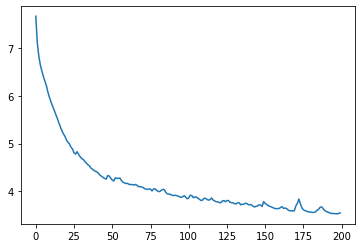

In [138]:
import matplotlib.pyplot as plt
plt.plot(total_loss)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


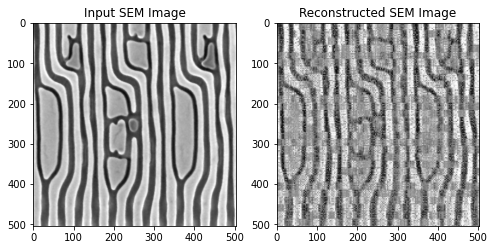

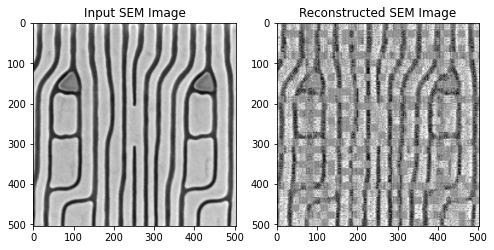

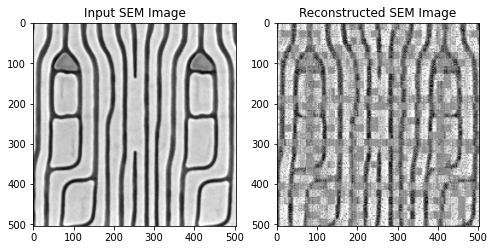

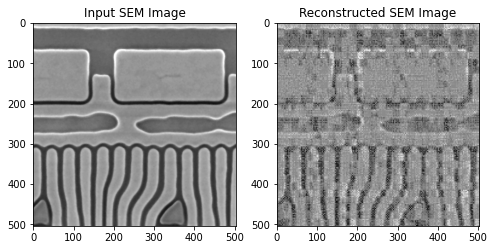

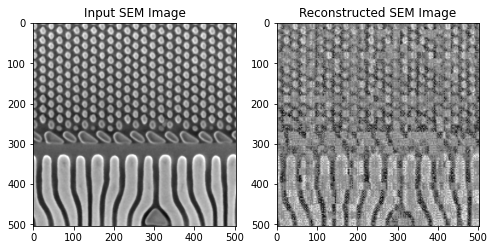

...

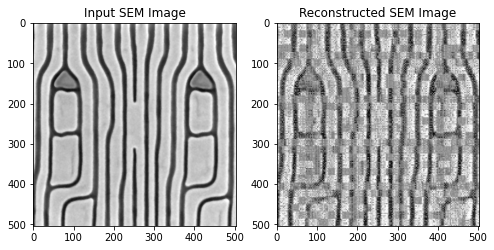

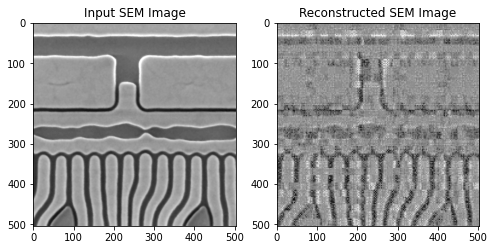

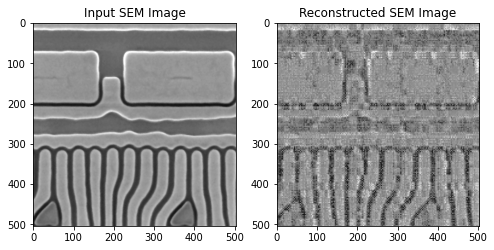

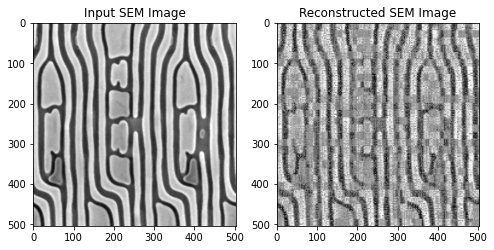

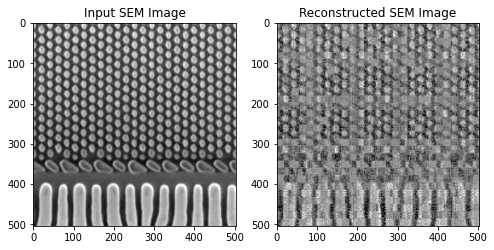

In [139]:
net.cpu()
net.eval()
counter = 0
for i in range(60):
    counter = counter + 1
    fig,ax = plt.subplots(1,2,figsize=(8,4))
    x = Data[i]
    input_img = x[0]
    #print(input_img)
    model_pred = net(x.unsqueeze(0))[0].cpu().data.numpy()[0]
    #print(model_pred)
    ax[0].set_title('Input SEM Image',fontsize=12)
    ax[1].set_title('Reconstructed SEM Image',fontsize=12)
    ax[0].imshow(input_img,cmap='gray',vmin=0,vmax=1)
    ax[1].imshow(model_pred,cmap='gray',vmin=0,vmax=1)


Extract Latent representation from Encoder 

Do Clustering and calculate Silhouette Score

In [140]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn import preprocessing
Encoder_net = Encoder()
Attributes = np.empty([len(train_loader),latent_dim])
#print(Attributes.shape)
for i,x in enumerate(Data):
  Temp_results = Encoder_net(x.unsqueeze(0))
  #print(Temp_results[0])
  Temp_Attributes = (Temp_results[0]).cpu().data.numpy()
  #print("Temp_Attributes:",Temp_Attributes)
  Attributes[i] = Temp_Attributes
  #print(Attributes[i].shape)
#print(Attributes.shape)

#On test set
Attributes_Test = np.empty([len(Test_data),128])
#print(Attributes.shape)
for i,x in enumerate(Test_data):
  Temp_results1 = Encoder_net(x.unsqueeze(0))
  #print(Temp_results[0])
  Temp_Attributes1 = (Temp_results1[0]).cpu().data.numpy()
  #print("Temp_Attributes:",Temp_Attributes)
  Attributes_Test[i] = Temp_Attributes1
  #print(Attributes[i].shape)
#print(Attributes.shape)

In [141]:
from sklearn.feature_selection import VarianceThreshold
k=8
Attributes_scaled = preprocessing.scale(Attributes)
print(Attributes_scaled.shape)
#print(Attributes_scaled.mean(axis=0))
print(Attributes_scaled.std(axis=0))
selector = VarianceThreshold()
Attributes_scaled = selector.fit_transform(Attributes_scaled)
print(Attributes_scaled.shape)
#print(Attributes_scaled.mean(axis=0))
print(Attributes_scaled.std(axis=0))
kmeans = KMeans(n_clusters=k,random_state=0).fit(Attributes_scaled)
Clustering_labels = kmeans.labels_
print(Clustering_labels)
Score = silhouette_score(Attributes_scaled,Clustering_labels,metric='euclidean')
print(Score)
sample_score = silhouette_samples(Attributes_scaled,Clustering_labels,metric='euclidean')
#print(sample_score)

(120, 128)
[1. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 0.
 1. 1. 1. 1. 1. 1. 0. 1. 1. 0. 1. 1. 0. 1. 0. 0. 0. 0. 1. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 1. 1. 1. 1. 0. 0. 1. 1. 1. 1. 0. 0. 0. 1. 1. 0. 1. 1. 0.
 1. 0. 1. 0. 0. 1. 1. 1. 0. 1. 0. 1. 1. 0. 0. 0. 0. 0. 0. 1. 1. 0. 0. 0.
 1. 1. 0. 0. 1. 1. 0. 0. 0. 0. 0. 1. 0. 1. 0. 1. 0. 1. 1. 1. 1. 1. 0. 1.
 0. 1. 1. 1. 0. 1. 0. 1.]
(120, 70)
[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
[3 0 4 1 7 2 3 3 1 1 0 4 3 7 3 3 1 7 5 3 6 1 1 1 1 1 6 1 0 2 7 1 4 7 0 1 7
 3 3 0 0 1 2 7 0 3 1 2 6 6 0 5 1 2 6 0 1 1 2 7 1 2 4 6 5 4 7 1 7 1 6 5 7 6
 7 4 4 5 3 1 2 1 6 7 2 1 7 3 3 1 7 7 3 6 1 1 3 0 6 7 1 4 3 6 4 5 6 1 4 2 1
 1 4 7 6 0 1 1 1 4]
0.15251402319728882


In [142]:
#On Test Data
k = 8
Attributes_Test_scaled = preprocessing.scale(Attributes_Test)
kmeans_Test = KMeans(n_clusters=k).fit(Attributes_Test_scaled)
Clustering_labels_Test = kmeans_Test.labels_
print(Clustering_labels_Test)
Score_Test = silhouette_score(Attributes_Test_scaled,Clustering_labels_Test,metric='euclidean')
print(Score_Test)
sample_score_Test = silhouette_samples(Attributes_Test_scaled,Clustering_labels_Test,metric='euclidean')

[7 6 1 2 7 1 3 4 7 7 4 7 3 1 1 3 7 4 2 0 4 3 3 0 3 4 3 3 5 4 3 3 1 4 2 7 1
 3 6 2 5 2 3 4 5 0 2 4 5 2]
0.12170182793061887


In [143]:
max(sample_score)

0.4099943449284584

Find Optimal K using Silhouette score

In [144]:
import pandas as pd 
column_names = ["Image","Label","Score"]
df = pd.DataFrame(columns = column_names,index=np.arange(len(Data)))
df['Image'][88]

for i,x in enumerate(Data):
  df['Image'][i] = (x[0]).data.numpy()
  df['Label'][i] = Clustering_labels[i]
  df['Score'][i] = sample_score[i]
  #print(input_img)
  df

In [145]:
df_Test = pd.DataFrame(columns = column_names,index=np.arange(len(Test_data)))
df_Test['Image'][48]
for i,x in enumerate(Test_data):
  df_Test['Image'][i] = (x[0]).data.numpy()
  df_Test['Label'][i] = Clustering_labels_Test[i]
  df_Test['Score'][i] = sample_score_Test[i]
  #print(input_img)
df_Test

,Image,Label,Score
0,"[[0.7294118, 0.72156864, 0.7019608, 0.6431373,...",7,0.207315
1,"[[0.42745098, 0.5372549, 0.7490196, 0.8980392,...",6,0.122258
2,"[[0.6666667, 0.65882355, 0.64705884, 0.6196078...",1,0.0179756
3,"[[0.09411765, 0.09803922, 0.11764706, 0.164705...",2,0.2257
4,"[[0.6862745, 0.6862745, 0.69411767, 0.69803923...",7,0.329139
5,"[[0.5568628, 0.5372549, 0.49411765, 0.42745098...",1,-0.131714
6,"[[0.63529414, 0.6313726, 0.627451, 0.627451, 0...",3,0.212651
7,"[[0.9529412, 0.94509804, 0.92941177, 0.9098039...",4,0.0668171
8,"[[0.67058825, 0.5803922, 0.41568628, 0.3294117...",7,0.247897
9,"[[0.654902, 0.6392157, 0.6117647, 0.5686275, 0...",7,0.227069


In [146]:
df= df.sort_values('Label',ignore_index=True)
print(df)
df['Image'][110]

                                                 Image Label      Score
0    [[0.39215687, 0.42352942, 0.6156863, 0.9568627...     0   0.409994
1    [[0.5176471, 0.54901963, 0.6784314, 0.9372549,...     0   0.401702
2    [[0.34509805, 0.3882353, 0.5647059, 0.827451, ...     0   0.260848
3    [[0.8627451, 0.88235295, 0.91764706, 0.9607843...     0   0.187261
4    [[0.47058824, 0.5686275, 0.7607843, 0.95686275...     0   0.340726
..                                                 ...   ...        ...
115  [[0.7176471, 0.7176471, 0.7137255, 0.70980394,...     7   0.220724
116  [[0.61960787, 0.5803922, 0.50980395, 0.4352941...     7   0.229447
117  [[0.8352941, 0.84313726, 0.84313726, 0.827451,...     7   0.253685
118  [[0.72156864, 0.7372549, 0.7529412, 0.7529412,...     7   0.244117
119  [[0.8666667, 0.8745098, 0.88235295, 0.8627451,...     7  0.0802819

[120 rows x 3 columns]


array([[0.64705884, 0.64705884, 0.6431373 , ..., 0.37254903, 0.40392157,
        0.42745098],
       [0.7019608 , 0.7019608 , 0.7019608 , ..., 0.39215687, 0.43529412,
        0.45882353],
       [0.79607844, 0.8       , 0.8156863 , ..., 0.4392157 , 0.49411765,
        0.5254902 ],
       ...,
       [0.40392157, 0.4117647 , 0.4117647 , ..., 0.6627451 , 0.78431374,
        0.80784315],
       [0.36078432, 0.3647059 , 0.3647059 , ..., 0.67058825, 0.7882353 ,
        0.8156863 ],
       [0.33333334, 0.33333334, 0.33333334, ..., 0.5647059 , 0.78431374,
        0.81960785]], dtype=float32)

In [147]:
df_Test= df_Test.sort_values('Label',ignore_index=True)
print(df_Test)
df_Test['Image'][40]

                                                Image Label       Score
0   [[0.9411765, 0.9137255, 0.74509805, 0.5254902,...     0    0.091359
1   [[0.827451, 0.8352941, 0.8509804, 0.8901961, 0...     0   0.0267364
2   [[0.94509804, 0.9529412, 0.972549, 1.0, 1.0, 1...     0   -0.115626
3   [[0.54901963, 0.5568628, 0.5686275, 0.5803922,...     1    0.165037
4   [[0.42745098, 0.4392157, 0.45490196, 0.4745098...     1    0.192389
5   [[0.38039216, 0.39215687, 0.4, 0.40784314, 0.4...     1    0.205418
6   [[0.57254905, 0.57254905, 0.5686275, 0.5490196...     1    0.152336
7   [[0.5568628, 0.5372549, 0.49411765, 0.42745098...     1   -0.131714
8   [[0.6666667, 0.65882355, 0.64705884, 0.6196078...     1   0.0179756
9   [[0.2901961, 0.2627451, 0.24705882, 0.23921569...     2   0.0737788
10  [[0.4392157, 0.44313726, 0.45490196, 0.4823529...     2   0.0517432
11  [[0.3019608, 0.19215687, 0.1254902, 0.09411765...     2    0.116716
12  [[0.09411765, 0.09803922, 0.11764706, 0.164705...     2     

array([[0.85882354, 0.85882354, 0.8666667 , ..., 0.84705883, 0.85490197,
        0.85882354],
       [0.85882354, 0.85882354, 0.87058824, ..., 0.8392157 , 0.84705883,
        0.85490197],
       [0.85490197, 0.85882354, 0.8666667 , ..., 0.83137256, 0.8392157 ,
        0.84313726],
       ...,
       [0.2       , 0.20392157, 0.21568628, ..., 0.8627451 , 0.8627451 ,
        0.8627451 ],
       [0.21176471, 0.21568628, 0.22745098, ..., 0.8627451 , 0.85882354,
        0.85490197],
       [0.21960784, 0.22352941, 0.23529412, ..., 0.85882354, 0.85490197,
        0.8509804 ]], dtype=float32)

120


<function matplotlib.pyplot.show>

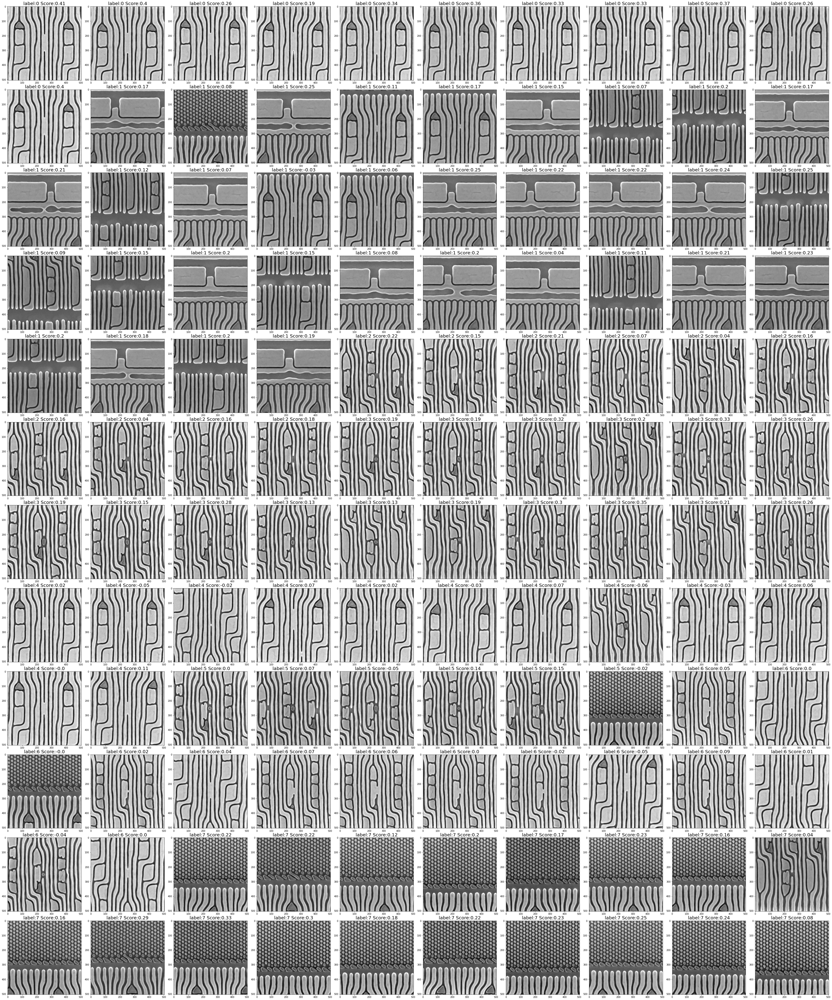

In [148]:
ncols = 10
print(len(Data))
nrows = int(len(Data)/ncols)
figsize = [50, 60]  
fig,ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axi = ax.flat
#print(len(axi))
for i,x in enumerate(Data):
  input_img = df['Image'][i]
  axi[i].set_title("label:"+str(df['Label'][i])+" "+"Score:"+str(round(df['Score'][i],2)),fontsize =20)
  axi[i].imshow(input_img,cmap='gray',vmin=0,vmax=1)
fig.tight_layout(pad=0.3)
plt.show

120


<function matplotlib.pyplot.show>

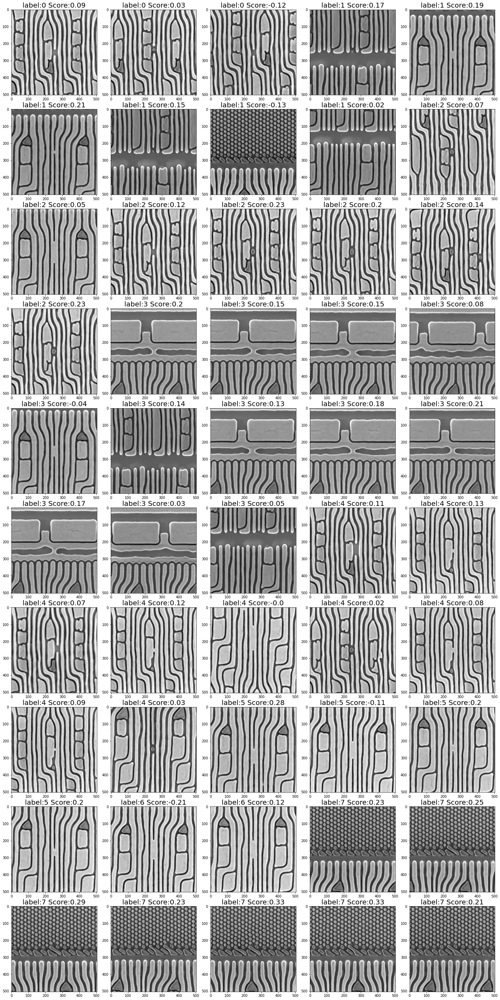

In [149]:
#Plot test Data
ncols = 5
print(len(Data))
nrows = int(len(Test_data)/ncols)
figsize = [20, 40]  
fig,ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=figsize)
axi = ax.flat
#print(len(axi))
for i,x in enumerate(Test_data):
  input_img1 = df_Test['Image'][i]
  axi[i].set_title("label:"+str(df_Test['Label'][i])+" "+"Score:"+str(round(df_Test['Score'][i],2)),fontsize =20)
  axi[i].imshow(input_img1,cmap='gray',vmin=0,vmax=1)
fig.tight_layout(pad=0.3)
plt.show

In [150]:
k_range = 20
Score = np.empty(20)
for k in range(k_range):
  kmeans = KMeans(n_clusters=k+2,random_state=0).fit(Attributes_scaled)
  Clustering_labels_k = kmeans.labels_
  Score[k] = silhouette_score(Attributes_scaled,Clustering_labels_k,metric='euclidean')
print(Score)
Max_score_k = np.argmax(Score) + 2
print(Max_score_k)


[0.16883978 0.15424492 0.16635197 0.17160547 0.15067862 0.14642933
 0.15251402 0.12228278 0.12341421 0.1205331  0.12651144 0.13109396
 0.12471351 0.12687486 0.12161179 0.11288014 0.11120416 0.112276
 0.11006071 0.11584934]
5
